<a href="https://colab.research.google.com/github/Catalystde/sentiment_analysis/blob/main/Sentimeny_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import sklearn
import cv2
from sklearn.metrics import confusion_matrix,roc_curve
import seaborn as sns
import datetime
import pathlib
import io
import os
import re
import string
import time
from numpy import random
import gensim.downloader as api
from PIL import Image
import tensorflow_datasets as tfds
import tensorflow_probability as tfp
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Layer
from tensorflow.keras.layers import (Dense,Flatten,SimpleRNN, InputLayer,Conv1D, Bidirectional , GRU , LSTM, BatchNormalization,Dropout, Input, Embedding, TextVectorization)
from tensorflow.keras.losses import BinaryCrossentropy, CategoricalCrossentropy, SparseCategoricalCrossentropy
from tensorflow.keras.metrics import Accuracy,TopKCategoricalAccuracy, CategoricalAccuracy, SparseCategoricalCrossentropy
from tensorflow.keras.optimizers import Adam
from google.colab import drive
from google.colab import files
from tensorboard.plugins import projector

In [2]:
BATCH_SIZE = 64

#Data Preparation

In [3]:
train_ds,val_ds,test_ds = tfds.load('imdb_reviews',split=['train','test[:50%]','test[50%:]'],as_supervised=True)

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Generating splits...:   0%|          | 0/3 [00:00<?, ? splits/s]

Generating train examples...:   0%|          | 0/25000 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/imdb_reviews/plain_text/incomplete.DNWB92_1.0.0/imdb_reviews-train.tfrecor…

Generating test examples...:   0%|          | 0/25000 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/imdb_reviews/plain_text/incomplete.DNWB92_1.0.0/imdb_reviews-test.tfrecord…

Generating unsupervised examples...:   0%|          | 0/50000 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/imdb_reviews/plain_text/incomplete.DNWB92_1.0.0/imdb_reviews-unsupervised.…

Dataset imdb_reviews downloaded and prepared to /root/tensorflow_datasets/imdb_reviews/plain_text/1.0.0. Subsequent calls will reuse this data.


In [4]:
train_ds

<_PrefetchDataset element_spec=(TensorSpec(shape=(), dtype=tf.string, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>

In [5]:
for review,label in train_ds.take(2):
  print(review)
  print(label)

tf.Tensor(b"This was an absolutely terrible movie. Don't be lured in by Christopher Walken or Michael Ironside. Both are great actors, but this must simply be their worst role in history. Even their great acting could not redeem this movie's ridiculous storyline. This movie is an early nineties US propaganda piece. The most pathetic scenes were those when the Columbian rebels were making their cases for revolutions. Maria Conchita Alonso appeared phony, and her pseudo-love affair with Walken was nothing but a pathetic emotional plug in a movie that was devoid of any real meaning. I am disappointed that there are movies like this, ruining actor's like Christopher Walken's good name. I could barely sit through it.", shape=(), dtype=string)
tf.Tensor(0, shape=(), dtype=int64)
tf.Tensor(b'I have been known to fall asleep during films, but this is usually due to a combination of things including, really tired, being warm and comfortable on the sette and having just eaten a lot. However on t

In [6]:
def standardization(input_data):
  lowercase = tf.strings.lower(input_data)
  no_tag = tf.strings.regex_replace(lowercase,"<[^>]+>","")
  output = tf.strings.regex_replace(no_tag,"[%s]"%re.escape(string.punctuation),"")
  return output

In [7]:
VOCAB_SIZE = 10000
SEQUENCE_LENGTH = 300

In [8]:
vectorize_layer = TextVectorization(
    standardize = standardization,
    max_tokens = VOCAB_SIZE,
    output_mode = 'int',
    output_sequence_length = SEQUENCE_LENGTH
)

In [9]:
# length = []
# words = []

# for review,label in train_ds.take(10):
#   for word in tf.strings.split(review,sep=" "):
#     if word in words:
#       pass
#     else:
#       words.append(word)
#   length.append(len(tf.strings.split(review,sep=" ")))

In [10]:
training_data = train_ds.map(lambda x,y:x)
vectorize_layer.adapt(training_data)

In [11]:
len(vectorize_layer.get_vocabulary())

10000

In [12]:
for review,label in train_ds.take(2):
  print(review)
  print(label)

tf.Tensor(b"This was an absolutely terrible movie. Don't be lured in by Christopher Walken or Michael Ironside. Both are great actors, but this must simply be their worst role in history. Even their great acting could not redeem this movie's ridiculous storyline. This movie is an early nineties US propaganda piece. The most pathetic scenes were those when the Columbian rebels were making their cases for revolutions. Maria Conchita Alonso appeared phony, and her pseudo-love affair with Walken was nothing but a pathetic emotional plug in a movie that was devoid of any real meaning. I am disappointed that there are movies like this, ruining actor's like Christopher Walken's good name. I could barely sit through it.", shape=(), dtype=string)
tf.Tensor(0, shape=(), dtype=int64)
tf.Tensor(b'I have been known to fall asleep during films, but this is usually due to a combination of things including, really tired, being warm and comfortable on the sette and having just eaten a lot. However on t

In [13]:
def vectorizer(review,label):
  return vectorize_layer(review),label

In [14]:
training_data = train_ds.map(vectorizer)
validation_data = val_ds.map(vectorizer)

In [15]:
for review,label in training_data.take(2):
  print(review)
  print(label)

tf.Tensor(
[  10   13   33  411  384   17   89   26    1    8   32 1337 3521   40
  491    1  192   22   84  149   18   10  215  317   26   64  239  212
    8  484   54   64   84  111   95   21 5502   10   91  637  737   10
   17    7   33  393 9554  169 2443  406    2   87 1205  135   65  142
   52    2    1 7408   65  245   64 2832   16    1 2851    1    1 1415
 4969    3   39    1 1567   15 3521   13  156   18    4 1205  881 7874
    8    4   17   12   13 4037    5   98  145 1234   11  236  696   12
   48   22   91   37   10 7285  149   37 1337    1   49  396   11   95
 1148  841  140    9    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0 

In [16]:
training_data = training_data.batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)
validation_data = validation_data.batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)

#SimpleRNN

In [ ]:
EMBEDDING_DIM = 64
model = tf.keras.models.Sequential([
    Input(shape=(SEQUENCE_LENGTH,)),
    Embedding(VOCAB_SIZE,EMBEDDING_DIM),
    SimpleRNN(32),
    Dense(1,activation='sigmoid')
])
model.summary()

In [ ]:
checkpoint_path = '/content/training/rnn.keras'
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath = checkpoint_path,
    monitor ='val_accuracy',
    mode = 'max',
    save_best_only =True
)

In [ ]:
model.compile(
    optimizer='adam',
    loss='binary_crossentropy',
    metrics=['accuracy']
    )

In [ ]:
history = model.fit(
    training_data,
    validation_data = validation_data,
    epochs = 10,
    callbacks = [model_checkpoint_callback]
)

Epoch 1/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 59s 150ms/step - accuracy: 0.6136 - loss: 0.5579 - val_accuracy: 0.4980 - val_loss: 0.8938
Epoch 2/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 83s 150ms/step - accuracy: 0.6309 - loss: 0.5313 - val_accuracy: 0.4988 - val_loss: 0.9278
Epoch 3/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 47s 119ms/step - accuracy: 0.6369 - loss: 0.5234 - val_accuracy: 0.4976 - val_loss: 0.9537
Epoch 4/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 44s 113ms/step - accuracy: 0.6467 - loss: 0.5133 - val_accuracy: 0.5003 - val_loss: 0.8736
Epoch 5/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 83s 116ms/step - accuracy: 0.6255 - loss: 0.5391 - val_accuracy: 0.4983 - val_loss: 0.9645
Epoch 6/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 43s 111ms/step - accuracy: 0.6342 - loss: 0.5245 - val_accuracy: 0.5014 - val_loss: 0.9750
Epoch 7/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 44s 112ms/step - accuracy: 0.6404 - loss: 0.5161 - val_accuracy: 0.5000 - val_loss: 1.0196
Epoch 8/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 81s 111ms/step - accuracy: 0.6512 - loss: 0

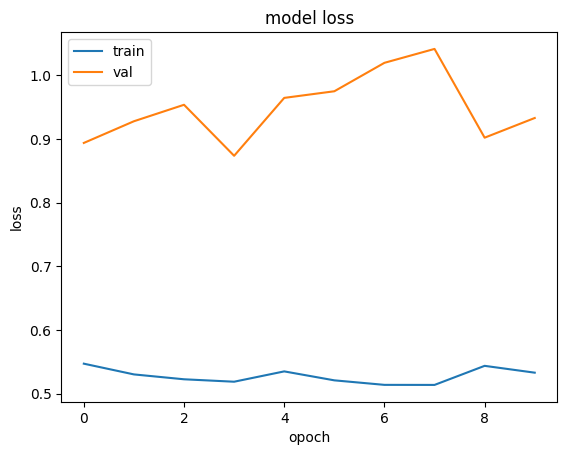

In [ ]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('opoch')
plt.legend(['train','val'],loc ='upper left')
plt.show()

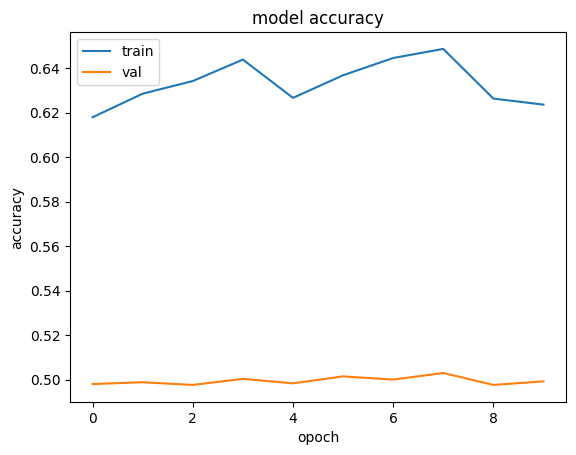

In [ ]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('opoch')
plt.legend(['train','val'],loc = 'upper left')
plt.show()

#LSTMs(Bidirectional and multilayer)

In [ ]:
EMBEDDING_DIM = 64
model = tf.keras.models.Sequential([
    Input(shape=(SEQUENCE_LENGTH,)),
    Embedding(VOCAB_SIZE,EMBEDDING_DIM),
    Bidirectional(LSTM(64,return_sequences=True)),
    Bidirectional(LSTM(32)),
    Dense(64,activation='relu'),
    Dropout(0.5),
    Dense(1,activation='sigmoid')
])
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ embedding (Embedding)                │ (None, 300, 64)             │         640,000 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ bidirectional (Bidirectional)        │ (None, 300, 128)            │          66,048 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ bidirectional_1 (Bidirectional)      │ (None, 64)                  │          41,216 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 64)                  │           4,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 1)                   │              65 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 751,489 (2.87 MB)

 Trainable params: 751,489 (2.87 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
checkpoint_path = '/content/training/lstm.keras'
model_checkpoint = tf.keras.callbacks.ModelCheckpoint(
    filepath = checkpoint_path,
    monitor = 'val_accuracy',
    mode = 'max',
    save_best_only = True
)

In [ ]:
model.compile(
               loss='binary_crossentropy',
               optimizer=tf.keras.optimizers.Adam(1e-4),
               metrics=['accuracy']
               )

In [ ]:
history = model.fit(
    training_data,
    validation_data = validation_data,
    epochs=10,
    callbacks = [model_checkpoint]
)

Epoch 1/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 33s 63ms/step - accuracy: 0.5408 - loss: 0.6764 - val_accuracy: 0.8406 - val_loss: 0.3789
Epoch 2/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 31s 80ms/step - accuracy: 0.8586 - loss: 0.3489 - val_accuracy: 0.8567 - val_loss: 0.3450
Epoch 3/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 26s 67ms/step - accuracy: 0.9045 - loss: 0.2585 - val_accuracy: 0.8694 - val_loss: 0.3428
Epoch 4/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 39s 61ms/step - accuracy: 0.9252 - loss: 0.2140 - val_accuracy: 0.8634 - val_loss: 0.3820
Epoch 5/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 24s 62ms/step - accuracy: 0.9365 - loss: 0.1907 - val_accuracy: 0.8466 - val_loss: 0.4202
Epoch 6/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 41s 62ms/step - accuracy: 0.9424 - loss: 0.1759 - val_accuracy: 0.8619 - val_loss: 0.3875
Epoch 7/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 43s 67ms/step - accuracy: 0.9461 - loss: 0.1659 - val_accuracy: 0.8567 - val_loss: 0.4125
Epoch 8/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 39s 62ms/step - accuracy: 0.9510 - loss: 0.1476 - 

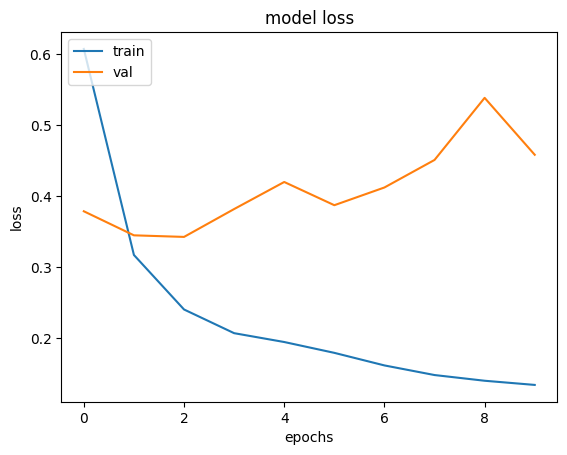

In [ ]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epochs')
plt.legend(['train','val'],loc ='upper left')
plt.show()

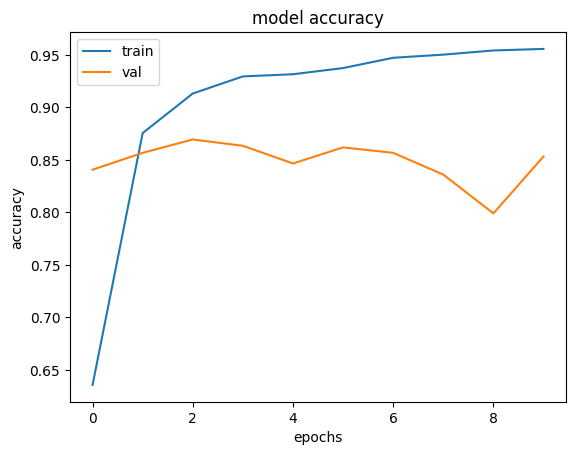

In [ ]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epochs')
plt.legend(['train','val'],loc = 'upper left')
plt.show()

In [ ]:
test_data = test_ds.map(vectorizer)
test_data = test_data.batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)
test_loss,test_accuracy = model.evaluate(test_data)
print(test_loss,test_accuracy)

196/196 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - accuracy: 0.8521 - loss: 0.4554
0.444921612739563 0.854640007019043


#GRU(Bidirectional and MultiLayer)

In [ ]:
EMBEDDING_DIM = 64
model = tf.keras.models.Sequential([
    Input(shape=(SEQUENCE_LENGTH,)),
    Embedding(VOCAB_SIZE,EMBEDDING_DIM),
    Bidirectional(GRU(64,return_sequences=True)),
    Bidirectional(GRU(32)),
    Dense(64,activation='relu'),
    Dropout(0.5),
    Dense(1,activation='sigmoid')
])
model.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ embedding_1 (Embedding)              │ (None, 300, 64)             │         640,000 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ bidirectional_2 (Bidirectional)      │ (None, 300, 128)            │          49,920 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ bidirectional_3 (Bidirectional)      │ (None, 64)                  │          31,104 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 64)                  │           4,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 1)                   │              65 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 725,249 (2.77 MB)

 Trainable params: 725,249 (2.77 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
checkpoint_path = '/content/training/gru.keras'
model_checkpoint = tf.keras.callbacks.ModelCheckpoint(
    filepath = checkpoint_path,
    monitor = 'val_accuracy',
    mode = 'max',
    save_best_only = True
)

In [ ]:
model.compile(
               loss='binary_crossentropy',
               optimizer=tf.keras.optimizers.Adam(1e-4),
               metrics=['accuracy']
               )

In [ ]:
history = model.fit(
    training_data,
    validation_data = validation_data,
    epochs=10,
    callbacks = [model_checkpoint]
)

Epoch 1/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 26s 58ms/step - accuracy: 0.5084 - loss: 0.6928 - val_accuracy: 0.5760 - val_loss: 0.6860
Epoch 2/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 42s 61ms/step - accuracy: 0.6551 - loss: 0.6341 - val_accuracy: 0.8297 - val_loss: 0.3857
Epoch 3/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 23s 59ms/step - accuracy: 0.8615 - loss: 0.3419 - val_accuracy: 0.8649 - val_loss: 0.3356
Epoch 4/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 41s 60ms/step - accuracy: 0.9049 - loss: 0.2541 - val_accuracy: 0.8631 - val_loss: 0.3684
Epoch 5/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 41s 60ms/step - accuracy: 0.9240 - loss: 0.2150 - val_accuracy: 0.8644 - val_loss: 0.3799
Epoch 6/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 23s 59ms/step - accuracy: 0.9321 - loss: 0.1957 - val_accuracy: 0.8640 - val_loss: 0.3680
Epoch 7/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 41s 58ms/step - accuracy: 0.9348 - loss: 0.1858 - val_accuracy: 0.8609 - val_loss: 0.4270
Epoch 8/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 42s 60ms/step - accuracy: 0.9461 - loss: 0.1599 - 

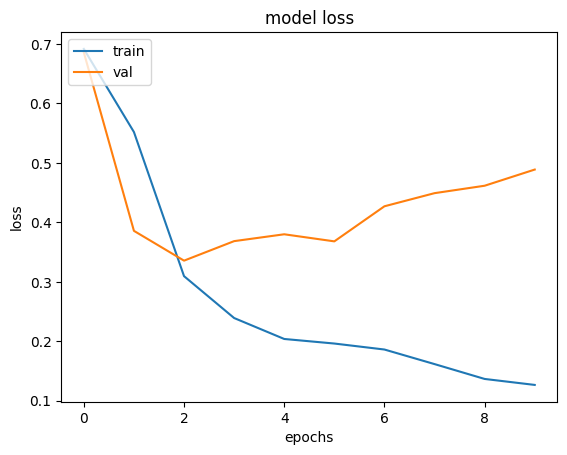

In [ ]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epochs')
plt.legend(['train','val'],loc ='upper left')
plt.show()

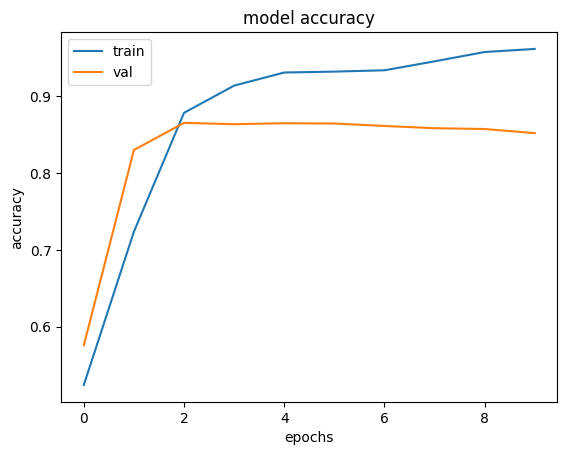

In [ ]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epochs')
plt.legend(['train','val'],loc = 'upper left')
plt.show()

In [ ]:
test_data = test_ds.map(vectorizer)
test_data = test_data.batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)
test_loss,test_accuracy = model.evaluate(test_data)
print(test_loss,test_accuracy)

196/196 ━━━━━━━━━━━━━━━━━━━━ 6s 28ms/step - accuracy: 0.8477 - loss: 0.4916
0.4833119809627533 0.8493599891662598


#Conv1D

In [ ]:
EMBEDDING_DIM = 300
# Assuming SEQUENCE_LENGTH and VOCAB_SIZE are defined
# Check if SEQUENCE_LENGTH is correctly set

model = tf.keras.models.Sequential([
    Input(shape=(SEQUENCE_LENGTH,), name="input_layer"), # Added name for clarity
    Embedding(VOCAB_SIZE, EMBEDDING_DIM, name="embedding_layer"), # Added name for clarity
    Conv1D(32, 3, activation='relu', name="conv1d_layer"), # Added name for clarity
    # Reshape layer added to explicitly define the shape before flattening
    tf.keras.layers.Reshape((-1, 32 * (SEQUENCE_LENGTH - 2))), # Calculate the output shape of Conv1D
    Flatten(name="flatten_layer"), # Added name for clarity
    Dense(32, activation='relu', name="dense_layer_1"), # Added name for clarity
    Dropout(0.5, name="dropout_layer"), # Added name for clarity
    Dense(1, activation='sigmoid', name="output_layer"), # Added name for clarity
])
model.summary()

Model: "sequential_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ embedding_layer (Embedding)          │ (None, 300, 300)            │       3,000,000 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv1d_layer (Conv1D)                │ (None, 298, 32)             │          28,832 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape (Reshape)                    │ (None, 1, 9536)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_layer (Flatten)              │ (None, 9536)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_layer_1 (Dense)                │ (None, 32)                  │         305,184 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_layer (Dropout)              │ (None, 32)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ output_layer (Dense)                 │ (None, 1)                   │              33 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 3,334,049 (12.72 MB)

 Trainable params: 3,334,049 (12.72 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
checkpoint_path2 = '/content/training/conv1d.keras'
model_checkpoint2 = tf.keras.callbacks.ModelCheckpoint(
    filepath = checkpoint_path2,
    monitor = 'val_accuracy',
    mode = 'max',
    save_best_only = True
)

In [ ]:
model.compile(
               loss='binary_crossentropy',
               optimizer=tf.keras.optimizers.Adam(1e-4),
               metrics=['accuracy']
               )

In [ ]:
history = model.fit(
    training_data,
    validation_data = validation_data,
    epochs=10,
    callbacks = [model_checkpoint2]
)

Epoch 1/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - accuracy: 0.4984 - loss: 0.6934 - val_accuracy: 0.5496 - val_loss: 0.6855
Epoch 2/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 17s 28ms/step - accuracy: 0.6759 - loss: 0.6036 - val_accuracy: 0.8613 - val_loss: 0.3375
Epoch 3/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 19s 25ms/step - accuracy: 0.8818 - loss: 0.2991 - val_accuracy: 0.8720 - val_loss: 0.3048
Epoch 4/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 10s 25ms/step - accuracy: 0.9186 - loss: 0.2237 - val_accuracy: 0.8692 - val_loss: 0.3175
Epoch 5/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 10s 23ms/step - accuracy: 0.9366 - loss: 0.1857 - val_accuracy: 0.8585 - val_loss: 0.3615
Epoch 6/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 10s 25ms/step - accuracy: 0.9490 - loss: 0.1580 - val_accuracy: 0.8633 - val_loss: 0.3581
Epoch 7/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 10s 25ms/step - accuracy: 0.9512 - loss: 0.1458 - val_accuracy: 0.8523 - val_loss: 0.4033
Epoch 8/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 10s 25ms/step - accuracy: 0.9640 - loss: 0.1164 - 

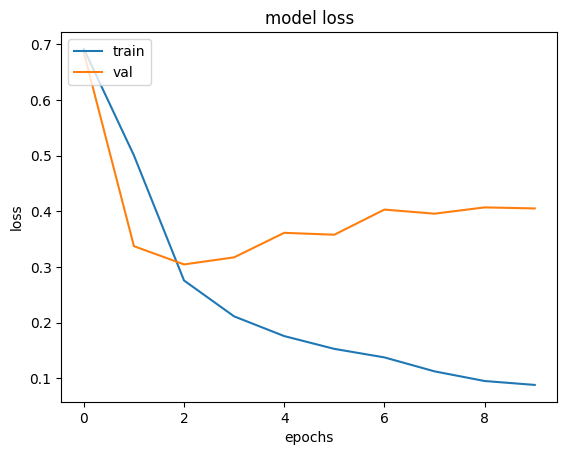

In [ ]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epochs')
plt.legend(['train','val'],loc ='upper left')
plt.show()

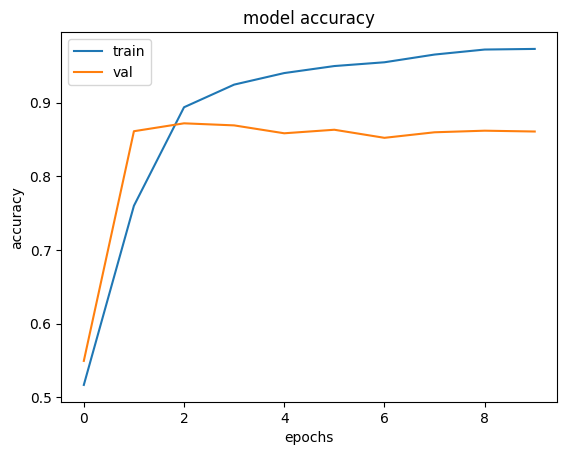

In [ ]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epochs')
plt.legend(['train','val'],loc = 'upper left')
plt.show()

In [ ]:
test_data = test_ds.map(vectorizer)
test_data = test_data.batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)
test_loss,test_accuracy = model.evaluate(test_data)
print(test_loss,test_accuracy)

196/196 ━━━━━━━━━━━━━━━━━━━━ 3s 15ms/step - accuracy: 0.8624 - loss: 0.4064
0.40015286207199097 0.864080011844635


#WordToVec[Gemsim]

In [ ]:
word2vec = api.load('word2vec-google-news-300')

[==================================================] 100.0% 1662.8/1662.8MB downloaded


In [21]:
word2vec.vectors.shape

(3000000, 300)

In [23]:
word2vec['The']

array([-0.17285156,  0.27929688,  0.10693359, -0.15820312, -0.08447266,
        0.05908203,  0.04077148,  0.00254822,  0.25976562,  0.18066406,
        0.09765625, -0.08105469, -0.01049805,  0.09814453,  0.00060272,
        0.07080078, -0.015625  , -0.09521484, -0.08105469, -0.02868652,
       -0.03320312,  0.16503906,  0.03979492, -0.03710938,  0.04101562,
       -0.12695312, -0.12890625,  0.12353516,  0.04980469,  0.01257324,
        0.05786133, -0.00830078, -0.02832031, -0.03320312,  0.16113281,
        0.07519531, -0.25976562,  0.08935547,  0.13574219,  0.00460815,
       -0.04418945,  0.02319336, -0.10449219, -0.05151367,  0.08349609,
       -0.02050781, -0.02172852, -0.02734375,  0.16015625,  0.19042969,
       -0.0324707 ,  0.06787109,  0.10302734, -0.25390625,  0.00634766,
        0.20507812,  0.02111816, -0.21679688, -0.02441406,  0.17089844,
       -0.21875   ,  0.10009766, -0.15527344, -0.12597656, -0.03833008,
       -0.05419922,  0.19238281,  0.21777344,  0.12109375, -0.02

In [35]:
word2vec.most_similar('man')

[('woman', 0.7664012908935547),
 ('boy', 0.6824871301651001),
 ('teenager', 0.6586930155754089),
 ('teenage_girl', 0.6147903203964233),
 ('girl', 0.5921714305877686),
 ('suspected_purse_snatcher', 0.571636438369751),
 ('robber', 0.5585119128227234),
 ('Robbery_suspect', 0.5584409832954407),
 ('teen_ager', 0.5549196600914001),
 ('men', 0.5489763021469116)]

In [38]:
pretrained_embedding = []

In [39]:
def first_caps(word):
  return word[0].upper()+word[1:]

In [41]:
for i in range(len(vectorize_layer.get_vocabulary())):
  try:
    pretrained_embedding.append(word2vec[vectorize_layer.get_vocabulary()[i]])
  except:
    print(vectorize_layer.get_vocabulary()[i])
    try:
      pretrained_embedding.append(word2vec[first_caps(vectorize_layer.get_vocabulary()[i])])
      print('toupper')
    except:
      print('nosolution')
      pretrained_embedding.append(random.normal(loc=0,scale=1,size=(300,)))


  if i%1000==0:
    print('i is===',i)


nosolution
i is=== 0
[UNK]
nosolution
and
toupper
a
toupper
of
toupper
to
toupper
doesnt
nosolution
didnt
nosolution
isnt
nosolution
wasnt
nosolution
10
nosolution
80s
nosolution
20
nosolution
70s
nosolution
i is=== 1000
15
nosolution
12
nosolution
30
nosolution
humour
toupper
100
nosolution
hasnt
nosolution
90
nosolution
shouldnt
nosolution
favourite
toupper
theatre
toupper
60s
nosolution
40
nosolution
lowbudget
nosolution
tarzan
toupper
50
nosolution
90s
nosolution
1950s
nosolution
i is=== 2000
keaton
toupper
welles
toupper
50s
nosolution
1010
nosolution
11
nosolution
1970s
nosolution
overthetop
nosolution
sinatra
toupper
columbo
toupper
1980s
nosolution
25
nosolution
1930s
nosolution
14
nosolution
13
nosolution
bmovie
nosolution
aint
toupper
pacino
toupper
moviethe
nosolution
writerdirector
nosolution
itthe
nosolution
lugosi
toupper
hitchcock
toupper
810
nosolution
i is=== 3000
30s
nosolution
filmthe
nosolution
2006
nosolution
1960s
nosolution
2000
nosolution
110
nosolution
wwii
no

In [17]:
pretrained_embeddings_array = np.array(pretrained_embedding)
print(pretrained_embeddings_array.shape)

NameError: name 'pretrained_embedding' is not defined

In [43]:
np.save('/content/drive/MyDrive/Colab Notebooks/Sentiment_analysis',pretrained_embeddings_array)

In [18]:
pretrained_embeddings_array = np.load('/content/drive/MyDrive/Colab Notebooks/Sentiment_analysis.npy')

In [19]:
EMBEDDING_DIM = 300
model = tf.keras.models.Sequential([
    Input(shape=(SEQUENCE_LENGTH,)),
    Embedding(
        VOCAB_SIZE,
        EMBEDDING_DIM,
        embeddings_initializer = tf.keras.initializers.Constant(pretrained_embeddings_array),
        trainable = False,
        ),
    Conv1D(32,3,activation='relu'),
    tf.keras.layers.Reshape((-1, 32 * (SEQUENCE_LENGTH - 2))), # Calculate the output shape of Conv1D
    Flatten(name="flatten_layer"), # Added name for clarity
    Flatten(),
    Dense(32,activation='relu'),
    Dropout(0.5),
    Dense(1,activation='sigmoid')
])
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ embedding (Embedding)                │ (None, 300, 300)            │       3,000,000 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv1d (Conv1D)                      │ (None, 298, 32)             │          28,832 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape (Reshape)                    │ (None, 1, 9536)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_layer (Flatten)              │ (None, 9536)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 9536)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 32)                  │         305,184 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 32)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 1)                   │              33 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 3,334,049 (12.72 MB)

 Trainable params: 334,049 (1.27 MB)

 Non-trainable params: 3,000,000 (11.44 MB)

In [20]:
checkpoint_path = '/content/drive/MyDrive/Colab Notebooks/Sentiment_analysis/word2vec.keras'
model_checkpoint = tf.keras.callbacks.ModelCheckpoint(
    filepath = checkpoint_path,
    monitor = 'val_accuracy',
    mode = 'max',
    save_best_only = True
)

In [23]:
model.compile(
               loss='binary_crossentropy',
               optimizer=tf.keras.optimizers.Adam(1e-4),
               metrics=['accuracy']
               )

In [36]:
log_dir='logs/imdb/fit/'+datetime.datetime.now().strftime("%Y%m%d-%H%M%S")+'/'
tensorboard_callback=tf.keras.callbacks.TensorBoard(log_dir,histogram_freq=1)

In [37]:
history = model.fit(
    training_data,
    validation_data = validation_data,
    epochs=10,
    callbacks = [tensorboard_callback]
)

Epoch 1/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - accuracy: 0.8745 - loss: 0.3078 - val_accuracy: 0.8290 - val_loss: 0.3861
Epoch 2/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - accuracy: 0.8819 - loss: 0.2921 - val_accuracy: 0.8277 - val_loss: 0.3895
Epoch 3/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 10s 26ms/step - accuracy: 0.8876 - loss: 0.2779 - val_accuracy: 0.8291 - val_loss: 0.3867
Epoch 4/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 13s 32ms/step - accuracy: 0.8992 - loss: 0.2599 - val_accuracy: 0.8284 - val_loss: 0.3935
Epoch 5/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - accuracy: 0.9064 - loss: 0.2450 - val_accuracy: 0.8272 - val_loss: 0.3991
Epoch 6/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 18s 26ms/step - accuracy: 0.9122 - loss: 0.2322 - val_accuracy: 0.8240 - val_loss: 0.4169
Epoch 7/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 9s 24ms/step - accuracy: 0.9171 - loss: 0.2196 - val_accuracy: 0.8239 - val_loss: 0.4208
Epoch 8/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - accuracy: 0.9252 - loss: 0.2033 - v

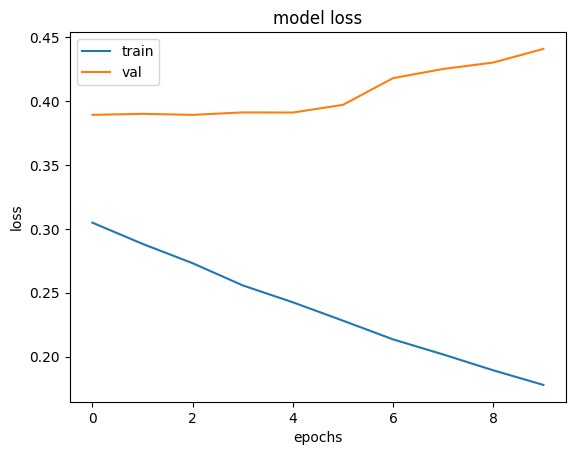

In [30]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epochs')
plt.legend(['train','val'],loc ='upper left')


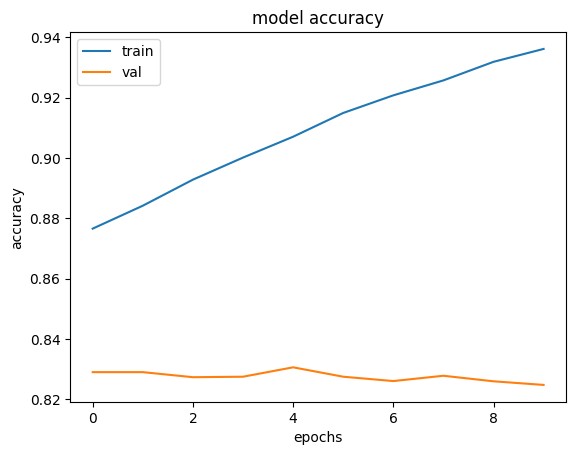

In [31]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epochs')
plt.legend(['train','val'],loc = 'upper left')
plt.show()

In [32]:
model.load_weights(checkpoint_path)

In [33]:
test_data = test_ds.map(vectorizer)
test_data = test_data.batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)
test_loss,test_accuracy = model.evaluate(test_data)


196/196 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step - accuracy: 0.8320 - loss: 0.3834


#Testing

In [63]:
test_data = tf.data.Dataset.from_tensor_slices([['this movie is a intresting movie I loved it but there could be a better ending Ending was not so good'],
                                                ['it was nice theme i liked it but overall i could not recommand this movie to anyone though i was a decent expirience to me']])

In [64]:
def vectorize_test(review):
  return vectorize_layer(review)
test_data = test_data.map(vectorize_test)

In [65]:
model.predict(test_data)

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step  


array([[0.46754065],
       [0.80181766]], dtype=float32)

#Inference Ready Testing

In [73]:
inputs = Input(shape=(1,), dtype="string")
vectorized_inputs=vectorize_layer(inputs)
outputs = model(vectorized_inputs)
inference_ready_model = tf.keras.Model(inputs, outputs)
inference_ready_model.summary()

Model: "functional_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_6 (InputLayer)           │ (None, 1)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ text_vectorization                   │ (None, 300)                 │               0 │
│ (TextVectorization)                  │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ sequential_2 (Sequential)            │ (None, 1)                   │       3,334,049 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 3,334,049 (12.72 MB)

 Trainable params: 334,049 (1.27 MB)

 Non-trainable params: 3,000,000 (11.44 MB)

In [74]:

# Convert the list of strings into a TensorFlow Dataset.
test_data = tf.data.Dataset.from_tensor_slices(
    ["this movie looks very interesting, i love the fact that the actors do a great job in showing how people lived in the 18th century, which wasn't very good at all. But atleast this movie recreates this scenes! ",
     "very good start, but movie started becoming interesting at some point and fortunately at some point it started becoming much more fun, though there was too much background noise, so in all i liked this movie "]
)

# Batch the dataset with a batch size of your choice (e.g., 1 for single predictions).
test_data = test_data.batch(1)

# Now, make the prediction using the batched dataset.
predictions = inference_model.predict(test_data)

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


In [75]:
print(predictions)

[[0.8924853]
 [0.6313769]]


#Visualization

In [38]:
with open(os.path.join(log_dir,'metadata.tsv'),"w") as f:
  for i in range(VOCAB_SIZE):
    f.write("{} {}\n".format(i,vectorize_layer.get_vocabulary()[i]))

In [41]:
embedding_weights = tf.Variable(model.layers[0].get_weights()[0])
print(embedding_weights.shape)

(10000, 300)


In [42]:
checkpoint=tf.train.Checkpoint(embedding=embedding_weights)
checkpoint.save(os.path.join(log_dir,"embedding.ckpt"))

config=projector.ProjectorConfig()
embedding=config.embeddings.add()

In [43]:
embedding.metadata_path='metadata.tsv'
projector.visualize_embeddings(log_dir,config)

In [44]:
%load_ext tensorboard

In [45]:
%tensorboard --logdir logs/imdb/fit/

<IPython.core.display.Javascript object>